### thymus human spatial atlas dissociated dataset curation
### notebook to read all single cell data before integration 
### preprocessing - for all datasets, supp was removed with cellbender - see "preprocessing" for details
### last edit 02/07/24


In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore')
import scanpy as sc
import scrublet as sl
import matplotlib as mpl
import numpy as np
import pandas as pd
import os
import anndata as ad
import scvi
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white', color_map='viridis')
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.5 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [2]:
Path = ''
os.chdir(Path)
meta = pd.read_csv('')
meta.columns = meta.columns.str.strip()
meta

,library,sample,path_raw_gex,starsolo_version,path_cellbender_gex,donor,chemistry_simple,chemistry_detail,chemistry_orig,study,...,age,age_num,age_unit,age_cont,age_group.1,sex,sample_id_tcrab,path_tcrab,mapped_with,SampleID_TCRgd
0,F21_TH_45N,FCAImmP7179370,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,F21,3GEX,10x 3' v2.0,3GEX,Park2020,...,16w,16.0,w,-24,fetal,M,NaN,NaN,NaN,NaN
1,F21_TH_45P,FCAImmP7179369,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,F21,3GEX,10x 3' v2.0,3GEX,Park2020,...,16w,16.0,w,-24,fetal,M,NaN,NaN,NaN,NaN
2,F23_TH_45N,FCAImmP7198635,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,F23,3GEX,10x 3' v2.0,3GEX,Park2020,...,11w,11.0,w,-29,fetal,M,NaN,NaN,NaN,NaN
3,F23_TH_45P,FCAImmP7198634,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,F23,3GEX,10x 3' v2.0,3GEX,Park2020,...,11w,11.0,w,-29,fetal,M,NaN,NaN,NaN,NaN
4,F29_TH_45N,FCAImmP7277557,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,F29,3GEX,10x 3' v2.0,3GEX,Park2020,...,17w,17.0,w,-23,fetal,F,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,TTA13,TTA13,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,P3,3GEX,10x 3' v2.0,3GEX,Park2020,...,6m,6.0,m,6,infant,M,NaN,NaN,NaN,NaN
73,TTA14,TTA14,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,P3,3GEX,10x 3' v2.0,3GEX,Park2020,...,6m,6.0,m,6,infant,M,NaN,NaN,NaN,NaN
74,TTA7,TTA7,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,P1,3GEX,10x 3' v2.0,3GEX,Park2020,...,15m,15.0,m,15,paediatric,M,NaN,NaN,NaN,NaN
75,TTA8,TTA8,/nfs/team205/vk8/irods_data/09_thymus/starsolo...,2.7.4a,/lustre/scratch126/cellgen/team205/sharedData/...,P1,3GEX,10x 3' v2.0,3GEX,Park2020,...,15m,15.0,m,15,paediatric,M,NaN,NaN,NaN,NaN


# Read all other data and merge with demultiplexd nuclei 

In [3]:
# read the rest of the libraries and run scrublet 
import warnings 
warnings.simplefilter("ignore")

In [21]:
X = pd.DataFrame(np.empty((0,0)))
obs = pd.DataFrame(index=X.index)
var = pd.DataFrame(index=X.columns) 
X = X.values

AnnData = ad.AnnData(X=X, obs=obs, var=var)
data = {}
for idx,f in enumerate(meta.iloc[:,1]):
#     if f!='sample6':
        print(str(idx))
        print(f)
        results_file = meta['path_cellbender_gex'][idx]+'/'+meta['library'][idx]+'_filtered.h5'
        print(results_file)
        adata = sc.read_10x_h5(results_file)
        adata.var_names_make_unique()
        sc.pp.filter_cells(adata, min_genes=400)
        print(meta['library'][idx])
        # add metadata 
        adata.obs['barcode'] = adata.obs.index
        adata.obs['sample_barcode'] = meta['sample'][idx] + '-' + adata.obs.index
        adata.obs.index = meta['library'][idx] + '-' + adata.obs.index
        adata.obs['batch'] = idx+meta.shape[0] # fix batch 
        adata.obs['chemistry_simple'] = meta['chemistry_simple'][idx]
        adata.obs['age_group'] = meta['age_group'][idx]
        adata.obs['age_numeric'] = meta['age_cont'][idx]
        adata.obs['sampleID_TCRab'] = meta['sample_id_tcrab'][idx]
        adata.obs['path_TCRab'] = meta['path_tcrab'][idx]
        adata.obs['path_cellbender_gex'] = meta['path_cellbender_gex'][idx]
        adata.obs['study'] = meta['study'][idx]
        adata.obs['study_group'] = meta['study_group'][idx]
        adata.obs['sample'] = meta['sample'][idx]
        adata.obs['enrichment'] = meta['sort'][idx]
        adata.obs['donor'] = meta['donor'][idx]
        adata.obs['cite'] = meta['cite'][idx]
        print(adata.shape)
        # doublet detection     
        sc.external.pp.scrublet(adata)
        AnnData = ad.concat([AnnData,adata],join='outer')

        print(AnnData.shape)
AnnData.obs.index.names = ['barcode']

reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F21_TH_45N/F21_TH_45N_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


0
FCAImmP7179370
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F21_TH_45N/F21_TH_45N_filtered.h5


 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 422 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16009 genes that are detected in less than 3 cells


F21_TH_45N
(4807, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:20)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 7.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F21_TH_45P/F21_TH_45P_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(4807, 36601)
1
FCAImmP7179369
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F21_TH_45P/F21_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 488 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17688 genes that are detected in less than 3 cells


F21_TH_45P
(4698, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:15)
reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F23_TH_45N/F23_TH_45N_filtered.h5


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 28.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.7%
(9505, 36601)
2
FCAImmP7198635
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F23_TH_45N/F23_TH_45N_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 403 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17096 genes that are detected in less than 3 cells


F23_TH_45N
(3790, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:16)
reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F23_TH_45P/F23_TH_45P_filtered.h5


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 17.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.5%
(13295, 36601)
3
FCAImmP7198634
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F23_TH_45P/F23_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 787 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18640 genes that are detected in less than 3 cells


F23_TH_45P
(3570, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:10)
reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45N/F29_TH_45N_filtered.h5


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 11.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.2%
(16865, 36601)
4
FCAImmP7277557
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45N/F29_TH_45N_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 96 cells that have less than 400 genes expressed
Running Scrublet
filtered out 20043 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


F29_TH_45N
(453, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:01)
reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45P/F29_TH_45P_filtered.h5


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 21.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.1%
(17318, 36601)
5
FCAImmP7277556
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45P/F29_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1609 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17288 genes that are detected in less than 3 cells


F29_TH_45P
(9085, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:18)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 5.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45P_5GEX/F29_TH_45P_5GEX_filtered.h5


(26403, 36601)
6
FCAImmP7292030
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F29_TH_45P_5GEX/F29_TH_45P_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 431 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16893 genes that are detected in less than 3 cells


F29_TH_45P_5GEX
(6672, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:21)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 5.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.5%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45N/F30_TH_45N_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(33075, 36601)
7
FCAImmP7277565
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45N/F30_TH_45N_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 498 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17300 genes that are detected in less than 3 cells
normalizing counts per cell


F30_TH_45N
(3382, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:12)


Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 15.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45P/F30_TH_45P_filtered.h5


(36457, 36601)
8
FCAImmP7277564
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45P/F30_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 438 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17404 genes that are detected in less than 3 cells


F30_TH_45P
(5686, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:20)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 6.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45P_5GEX/F30_TH_45P_5GEX_filtered.h5


(42143, 36601)
9
FCAImmP7292034
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F30_TH_45P_5GEX/F30_TH_45P_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 510 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17097 genes that are detected in less than 3 cells


F30_TH_45P_5GEX
(5902, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:17)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 9.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45N_1/F38_TH_45N_1_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 25 cells that have less than 400 genes expressed


(48045, 36601)
10
FCAImmP7528284
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45N_1/F38_TH_45N_1_filtered.h5


Running Scrublet
filtered out 18065 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


F38_TH_45N_1
(1686, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:03)


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 40.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45N_2/F38_TH_45N_2_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(49731, 36601)
11
FCAImmP7528285
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45N_2/F38_TH_45N_2_filtered.h5


filtered out 26 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17800 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


F38_TH_45N_2
(1979, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:04)


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 44.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45P/F38_TH_45P_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(51710, 36601)
12
FCAImmP7528283
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45P/F38_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 756 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18690 genes that are detected in less than 3 cells
normalizing counts per cell


F38_TH_45P
(3436, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:12)


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 6.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45P_5GEX/F38_TH_45P_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(55146, 36601)
13
FCAImmP7528294
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F38_TH_45P_5GEX/F38_TH_45P_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 471 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17333 genes that are detected in less than 3 cells


F38_TH_45P_5GEX
(3512, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:11)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 9.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45N/F41_TH_45N_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(58658, 36601)
14
FCAImmP7555852
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45N/F41_TH_45N_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 625 cells that have less than 400 genes expressed
Running Scrublet
filtered out 15750 genes that are detected in less than 3 cells


F41_TH_45N
(4197, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:17)


Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 12.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45N_5GEX/F41_TH_45N_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(62855, 36601)
15
FCAImmP7555861
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45N_5GEX/F41_TH_45N_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 400 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16167 genes that are detected in less than 3 cells
normalizing counts per cell


F41_TH_45N_5GEX
(2527, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:09)


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 22.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45P/F41_TH_45P_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(65382, 36601)
16
FCAImmP7555851
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45P/F41_TH_45P_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 658 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17428 genes that are detected in less than 3 cells


F41_TH_45P
(5024, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:21)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 7.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45P_5GEX/F41_TH_45P_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 255 cells that have less than 400 genes expressed


(70406, 36601)
17
FCAImmP7555860
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F41_TH_45P_5GEX/F41_TH_45P_5GEX_filtered.h5


Running Scrublet
filtered out 19115 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


F41_TH_45P_5GEX
(2095, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:06)


Automatically set threshold at doublet score = 0.42
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 6.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45N/F45_TH_45N_filtered.h5


(72501, 36601)
18
FCAImmP7579219
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45N/F45_TH_45N_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1246 cells that have less than 400 genes expressed
Running Scrublet


F45_TH_45N
(9682, 36601)


filtered out 15829 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:30)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 2.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45N_5GEX/F45_TH_45N_5GEX_filtered.h5


(82183, 36601)
19
FCAImmP7579231
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45N_5GEX/F45_TH_45N_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 242 cells that have less than 400 genes expressed
Running Scrublet


F45_TH_45N_5GEX
(7529, 36601)


filtered out 14994 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:20)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 4.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45P/F45_TH_45P_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(89712, 36601)
20
FCAImmP7579218
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45P/F45_TH_45P_filtered.h5


filtered out 932 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19440 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


F45_TH_45P
(3631, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:14)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 8.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45P_5GEX/F45_TH_45P_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(93343, 36601)
21
FCAImmP7579230
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F45_TH_45P_5GEX/F45_TH_45P_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 186 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18816 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


F45_TH_45P_5GEX
(2686, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:06)


Automatically set threshold at doublet score = 0.45
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 15.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.4%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F64_TH_TOT_5GEX_1/F64_TH_TOT_5GEX_1_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(96029, 36601)
22
FCAImmP7851890
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F64_TH_TOT_5GEX_1/F64_TH_TOT_5GEX_1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 344 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17140 genes that are detected in less than 3 cells


F64_TH_TOT_5GEX_1
(6021, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:25)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 9.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.4%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F64_TH_TOT_5GEX_2/F64_TH_TOT_5GEX_2_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(102050, 36601)
23
FCAImmP7851891
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F64_TH_TOT_5GEX_2/F64_TH_TOT_5GEX_2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 336 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17403 genes that are detected in less than 3 cells


F64_TH_TOT_5GEX_2
(6262, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:25)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 8.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_CD137_5GEX/F67_TH_CD137_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(108312, 36601)
24
FCAImmP7851896
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_CD137_5GEX/F67_TH_CD137_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 189 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18750 genes that are detected in less than 3 cells


F67_TH_CD137_5GEX
(3981, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:09)


Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_1/F67_TH_TOT_5GEX_1_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(112293, 36601)
25
FCAImmP7851892
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_1/F67_TH_TOT_5GEX_1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 971 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17870 genes that are detected in less than 3 cells


F67_TH_TOT_5GEX_1
(5058, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:21)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 5.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.4%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_2/F67_TH_TOT_5GEX_2_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(117351, 36601)
26
FCAImmP7851893
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_2/F67_TH_TOT_5GEX_2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 990 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18067 genes that are detected in less than 3 cells


F67_TH_TOT_5GEX_2
(4658, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:17)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 11.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.8%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_3/F67_TH_TOT_5GEX_3_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(122009, 36601)
27
FCAImmP7851894
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_3/F67_TH_TOT_5GEX_3_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 733 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17474 genes that are detected in less than 3 cells


F67_TH_TOT_5GEX_3
(4986, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:16)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 12.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_4/F67_TH_TOT_5GEX_4_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(126995, 36601)
28
FCAImmP7851895
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F67_TH_TOT_5GEX_4/F67_TH_TOT_5GEX_4_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1153 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18617 genes that are detected in less than 3 cells
normalizing counts per cell


F67_TH_TOT_5GEX_4
(4866, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:18)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 6.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F83_TH_EPCAM_5GEX/F83_TH_EPCAM_5GEX_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(131861, 36601)
29
F83_TH_EPCAM
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/F83_TH_EPCAM_5GEX/F83_TH_EPCAM_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 286 cells that have less than 400 genes expressed
Running Scrublet
filtered out 15258 genes that are detected in less than 3 cells


F83_TH_EPCAM_5GEX
(4572, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:18)


Automatically set threshold at doublet score = 0.50
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 18.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX1/GEX1_filtered.h5


(136433, 36601)
30
sample1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX1/GEX1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1031 cells that have less than 400 genes expressed
Running Scrublet


GEX1
(19165, 36601)


filtered out 16860 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:25)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX10/GEX10_filtered.h5


(155598, 36601)
31
sample10
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX10/GEX10_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 3362 cells that have less than 400 genes expressed
Running Scrublet


GEX10
(18698, 36601)


filtered out 17689 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:45)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX11/GEX11_filtered.h5


(174296, 36601)
32
sample11
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX11/GEX11_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 442 cells that have less than 400 genes expressed
Running Scrublet


GEX11
(20396, 36601)


filtered out 16684 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:00)


Automatically set threshold at doublet score = 0.69
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 8.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.4%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX12/GEX12_filtered.h5


(194692, 36601)
33
sample12
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX12/GEX12_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 233 cells that have less than 400 genes expressed
Running Scrublet


GEX12
(18375, 36601)


filtered out 17499 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:00)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX2/GEX2_filtered.h5


(213067, 36601)
34
sample2
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX2/GEX2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 502 cells that have less than 400 genes expressed
Running Scrublet


GEX2
(17914, 36601)


filtered out 18113 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:47)


Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX3/GEX3_filtered.h5


(230981, 36601)
35
sample3
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX3/GEX3_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 882 cells that have less than 400 genes expressed
Running Scrublet


GEX3
(18478, 36601)


filtered out 16916 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:19)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX4/GEX4_filtered.h5


(249459, 36601)
36
sample4
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX4/GEX4_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 5042 cells that have less than 400 genes expressed
Running Scrublet


GEX4
(21812, 36601)


filtered out 17609 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:57)


Automatically set threshold at doublet score = 0.71
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX5/GEX5_filtered.h5


(271271, 36601)
37
sample5
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX5/GEX5_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1792 cells that have less than 400 genes expressed
Running Scrublet


GEX5
(15952, 36601)


filtered out 17505 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:56)


Automatically set threshold at doublet score = 0.68
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX6/GEX6_filtered.h5


(287223, 36601)
38
sample6
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX6/GEX6_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1921 cells that have less than 400 genes expressed
Running Scrublet


GEX6
(20056, 36601)


filtered out 18108 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:51)


Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX8/GEX8_filtered.h5


(307279, 36601)
39
sample8
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX8/GEX8_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 3596 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19232 genes that are detected in less than 3 cells


GEX8
(11218, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:21)


Automatically set threshold at doublet score = 0.64
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX9/GEX9_filtered.h5


(318497, 36601)
40
sample9
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GEX9/GEX9_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 4897 cells that have less than 400 genes expressed
Running Scrublet


GEX9
(28229, 36601)


filtered out 16069 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:58)


Automatically set threshold at doublet score = 0.74
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466780/GSM4466780_filtered.h5


(346726, 36601)
41
baut1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466780/GSM4466780_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 5579 cells that have less than 400 genes expressed
Running Scrublet


GSM4466780
(33117, 36601)


filtered out 12533 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:02)


Automatically set threshold at doublet score = 0.09
Detected doublet rate = 18.5%
Estimated detectable doublet fraction = 74.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 25.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466781/GSM4466781_filtered.h5


(379843, 36601)
42
baut2
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466781/GSM4466781_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 3726 cells that have less than 400 genes expressed
Running Scrublet


GSM4466781
(18281, 36601)


filtered out 12341 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:26)


Automatically set threshold at doublet score = 0.20
Detected doublet rate = 4.0%
Estimated detectable doublet fraction = 36.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 10.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466782/GSM4466782_filtered.h5


(398124, 36601)
43
baut3
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466782/GSM4466782_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 3596 cells that have less than 400 genes expressed
Running Scrublet


GSM4466782
(19176, 36601)


filtered out 12161 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:29)


Automatically set threshold at doublet score = 0.17
Detected doublet rate = 5.9%
Estimated detectable doublet fraction = 43.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466783/GSM4466783_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(417300, 36601)
44
baut4
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466783/GSM4466783_filtered.h5


filtered out 1749 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16951 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


GSM4466783
(1180, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:04)


Automatically set threshold at doublet score = 0.35
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 23.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466784/GSM4466784_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 338 cells that have less than 400 genes expressed


(418480, 36601)
45
baut5
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466784/GSM4466784_filtered.h5
GSM4466784


Running Scrublet
filtered out 18066 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:02)


(851, 36601)
Automatically set threshold at doublet score = 0.32
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 26.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.8%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466785/GSM4466785_filtered.h5


(419331, 36601)
46
baut6
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4466785/GSM4466785_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1373 cells that have less than 400 genes expressed
Running Scrublet
filtered out 13282 genes that are detected in less than 3 cells


GSM4466785
(8838, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:17)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 2.2%
Estimated detectable doublet fraction = 55.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.9%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838951/GSM4838951_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(428169, 36601)
47
camp1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838951/GSM4838951_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 386 cells that have less than 400 genes expressed
Running Scrublet
filtered out 17085 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


GSM4838951
(2026, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:08)


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838952/GSM4838952_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(430195, 36601)
48
camp1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838952/GSM4838952_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1105 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16338 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


GSM4838952
(4416, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:10)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 8.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838953/GSM4838953_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(434611, 36601)
49
camp1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838953/GSM4838953_filtered.h5


 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 92 cells that have less than 400 genes expressed
Running Scrublet
filtered out 15583 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)


GSM4838953
(1905, 36601)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:07)


Automatically set threshold at doublet score = 0.41
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 18.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838954/GSM4838954_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(436516, 36601)
50
camp1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/GSM4838954/GSM4838954_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 371 cells that have less than 400 genes expressed
Running Scrublet
filtered out 13159 genes that are detected in less than 3 cells


GSM4838954
(4137, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:10)


Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 5.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T03_TH_TOT_5GEX_1/T03_TH_TOT_5GEX_1_filtered.h5


(440653, 36601)
51
T03_TH_TOT_5GEX_1_S1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T03_TH_TOT_5GEX_1/T03_TH_TOT_5GEX_1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 3253 cells that have less than 400 genes expressed
Running Scrublet
filtered out 20172 genes that are detected in less than 3 cells
normalizing counts per cell


T03_TH_TOT_5GEX_1
(6269, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:24)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T03_TH_TOT_5GEX_2/T03_TH_TOT_5GEX_2_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(446922, 36601)
52
T03_TH_TOT_5GEX_2_S2
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T03_TH_TOT_5GEX_2/T03_TH_TOT_5GEX_2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1157 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19312 genes that are detected in less than 3 cells


T03_TH_TOT_5GEX_2
(8187, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:29)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 5.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_1/T06_TH_TOT_5GEX_1_filtered.h5


(455109, 36601)
53
T06_TH_TOT_5GEX_1_S9
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_1/T06_TH_TOT_5GEX_1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 2472 cells that have less than 400 genes expressed
Running Scrublet


T06_TH_TOT_5GEX_1
(18186, 36601)


filtered out 17972 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:05)


Automatically set threshold at doublet score = 0.69
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 2.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_2/T06_TH_TOT_5GEX_2_filtered.h5


(473295, 36601)
54
T06_TH_TOT_5GEX_2_S10
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_2/T06_TH_TOT_5GEX_2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1582 cells that have less than 400 genes expressed
Running Scrublet


T06_TH_TOT_5GEX_2
(15133, 36601)


filtered out 18257 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:01)


Automatically set threshold at doublet score = 0.67
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 2.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_3/T06_TH_TOT_5GEX_3_filtered.h5


(488428, 36601)
55
T06_TH_TOT_5GEX_3_S11
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_3/T06_TH_TOT_5GEX_3_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1022 cells that have less than 400 genes expressed
Running Scrublet


T06_TH_TOT_5GEX_3
(18576, 36601)


filtered out 17583 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:05)


Automatically set threshold at doublet score = 0.69
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 4.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.5%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_4/T06_TH_TOT_5GEX_4_filtered.h5


(507004, 36601)
56
T06_TH_TOT_5GEX_4_S12
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T06_TH_TOT_5GEX_4/T06_TH_TOT_5GEX_4_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 2202 cells that have less than 400 genes expressed
Running Scrublet


T06_TH_TOT_5GEX_4
(17107, 36601)


filtered out 18010 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:09)


Automatically set threshold at doublet score = 0.68
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_EPCAM_5GEX/T07_TH_EPCAM_5GEX_filtered.h5


(524111, 36601)
57
T07_TH_EPCAM_S3
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_EPCAM_5GEX/T07_TH_EPCAM_5GEX_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1306 cells that have less than 400 genes expressed
Running Scrublet
filtered out 12146 genes that are detected in less than 3 cells


T07_TH_EPCAM_5GEX
(4336, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:14)


Automatically set threshold at doublet score = 0.36
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 33.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_TOT_5GEX_1/T07_TH_TOT_5GEX_1_filtered.h5


(528447, 36601)
58
T07_TH_TOT_1_S1
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_TOT_5GEX_1/T07_TH_TOT_5GEX_1_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1426 cells that have less than 400 genes expressed
Running Scrublet


T07_TH_TOT_5GEX_1
(8687, 36601)


filtered out 15487 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:21)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_TOT_5GEX_2/T07_TH_TOT_5GEX_2_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(537134, 36601)
59
T07_TH_TOT_2_S2
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/T07_TH_TOT_5GEX_2/T07_TH_TOT_5GEX_2_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1761 cells that have less than 400 genes expressed
Running Scrublet
filtered out 16345 genes that are detected in less than 3 cells


T07_TH_TOT_5GEX_2
(7663, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:18)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /nfs/team205/ny1/SingleCell/ThymusAtlas/ny1/22-03-07-cellbender/TA12571164/TA12571164_filtered.h5


(544797, 36601)
60
U40-THY-0-SC-F-1
/nfs/team205/ny1/SingleCell/ThymusAtlas/ny1/22-03-07-cellbender/TA12571164/TA12571164_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1931 cells that have less than 400 genes expressed
Running Scrublet


TA12571164
(11033, 36601)


filtered out 11268 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:29)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 2.7%
Estimated detectable doublet fraction = 55.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.8%


reading /nfs/team205/ny1/SingleCell/ThymusAtlas/ny1/22-03-07-cellbender/TA12571165/TA12571165_filtered.h5


(555830, 36601)
61
U40-THY-0-SC-F-2
/nfs/team205/ny1/SingleCell/ThymusAtlas/ny1/22-03-07-cellbender/TA12571165/TA12571165_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 903 cells that have less than 400 genes expressed
Running Scrublet


TA12571165
(13532, 36601)


filtered out 9806 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:55)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 25.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072427/TA13072427_filtered.h5


(569362, 36601)
62
U48-THY-0-SC-1_5GEX
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072427/TA13072427_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1158 cells that have less than 400 genes expressed
Running Scrublet


TA13072427
(19390, 36601)


filtered out 14481 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:52)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 2.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072428/TA13072428_filtered.h5


(588752, 36601)
63
U48-THY-0-SC-EPCP-1_5GEX
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072428/TA13072428_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1103 cells that have less than 400 genes expressed
Running Scrublet


TA13072428
(20725, 36601)


filtered out 11016 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:51)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 4.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072429/TA13072429_filtered.h5


(609477, 36601)
64
U48-THY-0-SC-EPCP-2_5GEX
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA13072429/TA13072429_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1138 cells that have less than 400 genes expressed
Running Scrublet


TA13072429
(21197, 36601)


filtered out 11082 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:49)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260012/TA9260012_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(630674, 36601)
65
TA9260012
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260012/TA9260012_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1000 cells that have less than 400 genes expressed
Running Scrublet
filtered out 20321 genes that are detected in less than 3 cells


TA9260012
(7878, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:18)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 5.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260013/TA9260013_filtered.h5


(638552, 36601)
66
TA9260013
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260013/TA9260013_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1617 cells that have less than 400 genes expressed
Running Scrublet
filtered out 18166 genes that are detected in less than 3 cells


TA9260013
(7288, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:20)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 6.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260014/TA9260014_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(645840, 36601)
67
TA9260014
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260014/TA9260014_filtered.h5


filtered out 3332 cells that have less than 400 genes expressed
Running Scrublet
filtered out 21421 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


TA9260014
(3220, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:05)


Automatically set threshold at doublet score = 0.46
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 19.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260015/TA9260015_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1925 cells that have less than 400 genes expressed


(649060, 36601)
68
TA9260015
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260015/TA9260015_filtered.h5


Running Scrublet
filtered out 21698 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


TA9260015
(2479, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:03)


Automatically set threshold at doublet score = 0.44
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 7.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.1%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260016/TA9260016_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(651539, 36601)
69
TA9260016
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260016/TA9260016_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1578 cells that have less than 400 genes expressed
Running Scrublet
filtered out 21770 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


TA9260016
(2902, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:06)


Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.5%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260017/TA9260017_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 40 cells that have less than 400 genes expressed
Running Scrublet
filtered out 26634 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


(654441, 36601)
70
TA9260017
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TA9260017/TA9260017_filtered.h5
TA9260017
(182, 36601)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:00)


Automatically set threshold at doublet score = 0.20
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 4.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 12.5%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA10/TTA10_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(654623, 36601)
71
TTA10
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA10/TTA10_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1479 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19618 genes that are detected in less than 3 cells


TTA10
(11734, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:25)


Automatically set threshold at doublet score = 0.64
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.6%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA13/TTA13_filtered.h5


(666357, 36601)
72
TTA13
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA13/TTA13_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 8209 cells that have less than 400 genes expressed
Running Scrublet


TTA13
(19365, 36601)


filtered out 18924 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:53)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA14/TTA14_filtered.h5


(685722, 36601)
73
TTA14
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA14/TTA14_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1108 cells that have less than 400 genes expressed
Running Scrublet


TTA14
(18675, 36601)


filtered out 19085 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:42)


Automatically set threshold at doublet score = 0.68
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA7/TTA7_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(704397, 36601)
74
TTA7
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA7/TTA7_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 2135 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19828 genes that are detected in less than 3 cells
normalizing counts per cell


TTA7
(5473, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:17)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.5%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA8/TTA8_filtered.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)


(709870, 36601)
75
TTA8
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA8/TTA8_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1989 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19911 genes that are detected in less than 3 cells
normalizing counts per cell


TTA8
(5305, 36601)


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:12)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 5.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


reading /lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA9/TTA9_filtered.h5


(715175, 36601)
76
TTA9
/lustre/scratch126/cellgen/team205/sharedData/ny1/22-03-07-cellbender/TTA9/TTA9_filtered.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
filtered out 1414 cells that have less than 400 genes expressed
Running Scrublet
filtered out 19596 genes that are detected in less than 3 cells


TTA9
(11378, 36601)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:00:24)


Automatically set threshold at doublet score = 0.63
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.9%
(726553, 36601)


# QC MT and counts

In [23]:
# qc
# mitochondrial genes
AnnData.var['mt'] = AnnData.var_names.str.startswith('MT-') 
# ribosomal genes
AnnData.var['ribo'] = AnnData.var_names.str.startswith(("RPS","RPL"))
# hemoglobin genes.
AnnData.var['hb'] = AnnData.var_names.str.contains(("^HB[^(P)]"))

sc.pp.calculate_qc_metrics(AnnData, qc_vars=['mt','ribo','hb'], percent_top=None, log1p=False, inplace=True)
AnnData.obs

,n_genes,barcode,sample_barcode,batch,chemistry_simple,age_group,age_numeric,sampleID_TCRab,path_TCRab,path_cellbender_gex,...,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb
barcode,,,,,,,,,,,,,,,,,,,,,
F21_TH_45N-CAGCTGGCACCAACCG,5919,CAGCTGGCACCAACCG,FCAImmP7179370-CAGCTGGCACCAACCG,77,3GEX,fetal,-24,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.092291,False,5919,42780.0,883.0,2.064049,15191.0,35.509583,687.0,1.605891
F21_TH_45N-TAGGCATCACTCAGGC,5303,TAGGCATCACTCAGGC,FCAImmP7179370-TAGGCATCACTCAGGC,77,3GEX,fetal,-24,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.087683,False,5303,39249.0,807.0,2.056103,14015.0,35.707916,89.0,0.226757
F21_TH_45N-TCTGGAATCCCTAACC,5359,TCTGGAATCCCTAACC,FCAImmP7179370-TCTGGAATCCCTAACC,77,3GEX,fetal,-24,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.087683,False,5359,38303.0,766.0,1.999843,10692.0,27.914261,2.0,0.005222
F21_TH_45N-GCATACAGTTATCCGA,5478,GCATACAGTTATCCGA,FCAImmP7179370-GCATACAGTTATCCGA,77,3GEX,fetal,-24,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.092291,False,5478,38085.0,940.0,2.468163,12735.0,33.438362,194.0,0.509387
F21_TH_45N-TGAGAGGTCTGTCAAG,5010,TGAGAGGTCTGTCAAG,FCAImmP7179370-TGAGAGGTCTGTCAAG,77,3GEX,fetal,-24,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.037691,False,5010,37743.0,1076.0,2.850860,12312.0,32.620617,6.0,0.015897
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTA9-ATCGAGTAGTGCGATG,409,ATCGAGTAGTGCGATG,TTA9-ATCGAGTAGTGCGATG,153,3GEX,paed(early),15,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.033898,False,409,559.0,1.0,0.178891,91.0,16.279070,0.0,0.000000
TTA9-CATTCGCGTAGCGTGA,408,CATTCGCGTAGCGTGA,TTA9-CATTCGCGTAGCGTGA,153,3GEX,paed(early),15,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.039326,False,408,561.0,8.0,1.426025,83.0,14.795009,0.0,0.000000
TTA9-CGTTCTGAGAAGGGTA,400,CGTTCTGAGAAGGGTA,TTA9-CGTTCTGAGAAGGGTA,153,3GEX,paed(early),15,NaN,NaN,/lustre/scratch126/cellgen/team205/sharedData/...,...,0.103068,False,400,561.0,10.0,1.782531,88.0,15.686275,0.0,0.000000


In [24]:
mito_genes = AnnData.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
AnnData.obs['percent_mt2'] = np.sum(AnnData[:, mito_genes].X, axis=1).A1 / np.sum(AnnData.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
AnnData.obs['n_counts'] = AnnData.X.sum(axis=1).A1

... storing 'barcode' as categorical
... storing 'sample_barcode' as categorical
... storing 'chemistry_simple' as categorical
... storing 'age_group' as categorical
... storing 'sampleID_TCRab' as categorical
... storing 'path_TCRab' as categorical
... storing 'path_cellbender_gex' as categorical
... storing 'study' as categorical
... storing 'study_group' as categorical
... storing 'sample' as categorical
... storing 'enrichment' as categorical
... storing 'donor' as categorical


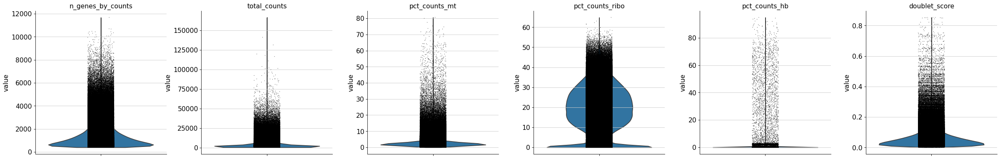

In [25]:
sc.pl.violin(AnnData, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo', 'pct_counts_hb','doublet_score'],
             jitter=0.1, multi_panel=True)

In [26]:
AnnData.obs['barcode_sequence'] = AnnData.obs['barcode']

In [27]:
AnnData.obs = AnnData.obs.drop(columns='barcode')

In [28]:
AnnData.obs

,n_genes,sample_barcode,batch,chemistry_simple,age_group,age_numeric,sampleID_TCRab,path_TCRab,path_cellbender_gex,study,...,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,percent_mt2,n_counts,barcode_sequence
barcode,,,,,,,,,,,,,,,,,,,,,
F21_TH_45N-CAGCTGGCACCAACCG,5919,FCAImmP7179370-CAGCTGGCACCAACCG,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,42780.0,883.0,2.064049,15191.0,35.509583,687.0,1.605891,0.020640,42780.0,CAGCTGGCACCAACCG
F21_TH_45N-TAGGCATCACTCAGGC,5303,FCAImmP7179370-TAGGCATCACTCAGGC,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,39249.0,807.0,2.056103,14015.0,35.707916,89.0,0.226757,0.020561,39249.0,TAGGCATCACTCAGGC
F21_TH_45N-TCTGGAATCCCTAACC,5359,FCAImmP7179370-TCTGGAATCCCTAACC,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,38303.0,766.0,1.999843,10692.0,27.914261,2.0,0.005222,0.019998,38303.0,TCTGGAATCCCTAACC
F21_TH_45N-GCATACAGTTATCCGA,5478,FCAImmP7179370-GCATACAGTTATCCGA,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,38085.0,940.0,2.468163,12735.0,33.438362,194.0,0.509387,0.024682,38085.0,GCATACAGTTATCCGA
F21_TH_45N-TGAGAGGTCTGTCAAG,5010,FCAImmP7179370-TGAGAGGTCTGTCAAG,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,37743.0,1076.0,2.850860,12312.0,32.620617,6.0,0.015897,0.028509,37743.0,TGAGAGGTCTGTCAAG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTA9-ATCGAGTAGTGCGATG,409,TTA9-ATCGAGTAGTGCGATG,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,559.0,1.0,0.178891,91.0,16.279070,0.0,0.000000,0.001789,559.0,ATCGAGTAGTGCGATG
TTA9-CATTCGCGTAGCGTGA,408,TTA9-CATTCGCGTAGCGTGA,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,561.0,8.0,1.426025,83.0,14.795009,0.0,0.000000,0.014260,561.0,CATTCGCGTAGCGTGA
TTA9-CGTTCTGAGAAGGGTA,400,TTA9-CGTTCTGAGAAGGGTA,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,561.0,10.0,1.782531,88.0,15.686275,0.0,0.000000,0.017825,561.0,CGTTCTGAGAAGGGTA


In [29]:
AnnData

AnnData object with n_obs × n_vars = 726553 × 36601
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex', 'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [30]:
# save raw data pre QC
AnnData.write_h5ad('')


In [31]:
# remove poor quality cells
AnnData = AnnData[AnnData.obs.n_genes_by_counts < 6500, :]
AnnData = AnnData[AnnData.obs.pct_counts_mt < 6, :]
AnnData = AnnData[AnnData.obs.pct_counts_ribo > 5, :]
AnnData.obs['cite'].value_counts()

False    400271
True     188009
Name: cite, dtype: int64

In [32]:
AnnData.var_names_make_unique()
AnnData.obs

,n_genes,sample_barcode,batch,chemistry_simple,age_group,age_numeric,sampleID_TCRab,path_TCRab,path_cellbender_gex,study,...,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,percent_mt2,n_counts,barcode_sequence
barcode,,,,,,,,,,,,,,,,,,,,,
F21_TH_45N-CAGCTGGCACCAACCG,5919,FCAImmP7179370-CAGCTGGCACCAACCG,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,42780.0,883.0,2.064049,15191.0,35.509583,687.0,1.605891,0.020640,42780.0,CAGCTGGCACCAACCG
F21_TH_45N-TAGGCATCACTCAGGC,5303,FCAImmP7179370-TAGGCATCACTCAGGC,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,39249.0,807.0,2.056103,14015.0,35.707916,89.0,0.226757,0.020561,39249.0,TAGGCATCACTCAGGC
F21_TH_45N-TCTGGAATCCCTAACC,5359,FCAImmP7179370-TCTGGAATCCCTAACC,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,38303.0,766.0,1.999843,10692.0,27.914261,2.0,0.005222,0.019998,38303.0,TCTGGAATCCCTAACC
F21_TH_45N-GCATACAGTTATCCGA,5478,FCAImmP7179370-GCATACAGTTATCCGA,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,38085.0,940.0,2.468163,12735.0,33.438362,194.0,0.509387,0.024682,38085.0,GCATACAGTTATCCGA
F21_TH_45N-TGAGAGGTCTGTCAAG,5010,FCAImmP7179370-TGAGAGGTCTGTCAAG,77,3GEX,fetal,-24,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,37743.0,1076.0,2.850860,12312.0,32.620617,6.0,0.015897,0.028509,37743.0,TGAGAGGTCTGTCAAG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTA9-ATCGAGTAGTGCGATG,409,TTA9-ATCGAGTAGTGCGATG,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,559.0,1.0,0.178891,91.0,16.279070,0.0,0.000000,0.001789,559.0,ATCGAGTAGTGCGATG
TTA9-CATTCGCGTAGCGTGA,408,TTA9-CATTCGCGTAGCGTGA,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,561.0,8.0,1.426025,83.0,14.795009,0.0,0.000000,0.014260,561.0,CATTCGCGTAGCGTGA
TTA9-CGTTCTGAGAAGGGTA,400,TTA9-CGTTCTGAGAAGGGTA,153,3GEX,paed(early),15,nan,nan,/lustre/scratch126/cellgen/team205/sharedData/...,Park2020,...,561.0,10.0,1.782531,88.0,15.686275,0.0,0.000000,0.017825,561.0,CGTTCTGAGAAGGGTA


In [33]:
AnnData.write_h5ad('')

In [3]:
AnnData = sc.read_h5ad('')

# SCVI integration 

In [5]:
AnnData_r = AnnData.copy()  # generate a temp AnnData 
AnnData_r.layers["counts"] = AnnData_r.X.copy() # preserve counts
AnnData_r.obs = AnnData.obs # recover counts
AnnData_r.var = AnnData.var # recover var names 
AnnData_r

AnnData object with n_obs × n_vars = 588280 × 36601
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex', 'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

## step 1 - remove cc and mt genes 

In [6]:
genes = {'cc_genes' : ['C1orf112', 'KDM1A', 'ARHGAP33', 'CDC27', 'AC004381.6', 'DBF4', 'PRSS21', 'E2F2', 'BAZ1B', 'NCAPD2', 'ANLN', 'BRCA1', 'UBR7', 'DDX11', 'TACC3', 'POLA2', 'DEPDC1', 'NCAPH2', 'HMGB3', 'CENPQ', 'DEPDC1B', 'SPDL1', 'TDP1', 'DSG2', 'NOP16', 'RFC2', 'RAD51', 'POLQ', 'THOC3', 'MRTO4', 'C4orf27', 'POLD1', 'TM7SF3', 'MCM10', 'MTHFD2', 'YBX1', 'ASPM', 'PRR11', 'NUCKS1', 'EXOC5', 'TCOF1', 'RAD18', 'TRIP13', 'DAZAP1', 'HLTF', 'PDCD2', 'SMC1A', 'HMMR', 'MCM2', 'NUP37', 'GTSE1', 'WDR62', 'MCM6', 'MLH1', 'UNG', 'SPAG5', 'UBE2T', 'EXOSC5', 'FAM76B', 'POLD3', 'KIF22', 'PUM3', 'RBL1', 'NDC80', 'HSPB11', 'OXCT1', 'SEH1L', 'ORC1', 'RAD54L', 'NOP14', 'GMCL1', 'AURKA', 'TPX2', 'BIRC5', 'KIF4A', 'FH', 'ORC6', 'G2E3', 'WDR76', 'PHGDH', 'CLSPN', 'NUP50', 'CDC45', 'CDC6', 'CBX5', 'MSH2', 'FKBP5', 'ACOT7', 'CDC7', 'RANBP1', 'CENPM', 'HMGXB4', 'MCM5', 'RANGAP1', 'POLE2', 'CDKN3', 'ERH', 'MTHFD1', 'VRK1', 'EMC9', 'GINS1', 'MYBL2', 'CDC25B', 'PLCB4', 'FAM83D', 'CEP76', 'RBBP8', 'POLA1', 'NUP93', 'CTCF', 'CCP110', 'CEP152', 'OIP5', 'MYEF2', 'MCM4', 'KCTD9', 'RNASEH2A', 'SGTA', 'ASF1B', 'LIG1', 'H2AFV', 'GARS', 'NUDT1', 'RPA3', 'EZH2', 'RHEB', 'SMC3', 'UBE2S', 'RAD51C', 'GALK1', 'C1QBP', 'BLMH', 'TMEM97', 'GAR1', 'NEIL3', 'WHSC1', 'NCAPG', 'CCDC34', 'CCDC86', 'MAGOHB', 'FOXM1', 'GPN3', 'RAD51AP1', 'RFC5', 'NUP107', 'TIMELESS', 'GAPDH', 'CDCA3', 'ENO2', 'FBXO5', 'MCM3', 'BAG2', 'GMNN', 'TTK', 'HMGCS1', 'BRD8', 'KIF20A', 'LMNB1', 'NUP155', 'H2AFY', 'SMC4', 'ECT2', 'CENPA', 'FHL2', 'MSH6', 'DHCR24', 'LRRC42', 'WDR77', 'SRM', 'MAD2L2', 'UCHL5', 'TTF2', 'SLC2A1', 'EBNA1BP2', 'CDC20', 'STMN1', 'NEK2', 'CENPF', 'KIF14', 'CASP8AP2', 'CTNNAL1', 'WDR34', 'PHF19', 'ACYP1', 'EPCAM', 'HELLS', 'CENPL', 'ACAT2', 'MASTL', 'EXOSC8', 'TMPO', 'NFYB', 'NCAPH', 'MND1', 'KIF18A', 'GPSM2', 'GTF3A', 'MRPS2', 'CCDC18', 'CISD1', 'ZWINT', 'CIT', 'DDX39A', 'CENPK', 'CDK2', 'TUBA1B', 'STIL', 'HJURP', 'EXOSC9', 'CKS2', 'ACSL3', 'CSE1L', 'HIST1H1D', 'HIST1H1A', 'DEK', 'GOT2', 'MGME1', 'MCM8', 'HNRNPR', 'BCL2L12', 'TRAP1', 'DLGAP5', 'YEATS4', 'PKMYT1', 'SRD5A3', 'PAICS', 'HAT1', 'KNSTRN', 'DUT', 'E2F8', 'FAM64A', 'MIS18BP1', 'SGOL1', 'RPS4Y1', 'LDLR', 'TOMM40', 'ATP8B3', 'LSM4', 'DNMT1', 'GINS2', 'TUBG1', 'PSMC3IP', 'THOC6', 'TOP2A', 'ENOSF1', 'RAN', 'RPA1', 'PCNA', 'NASP', 'RFC3', 'SLF1', 'LRRCC1', 'CCNB1', 'PSRC1', 'TMEM106C', 'LDHA', 'DDB2', 'CDCA8', 'TPGS2', 'SLC43A3', 'C9orf40', 'TROAP', 'ESPL1', 'NTPCR', 'CKAP2', 'BORA', 'NUDT15', 'BRIP1', 'ACTL6A', 'TXN', 'ODF2', 'SMC2', 'CDK5RAP2', 'ANP32B', 'DSCC1', 'ARHGEF39', 'PPIL1', 'TCF19', 'NRM', 'GGH', 'BUD13', 'CTDSPL2', 'NUSAP1', 'KIF23', 'CASC5', 'CENPO', 'KIF11', 'CEP55', 'KIF20B', 'DNA2', 'BARD1', 'MNS1', 'ZGRF1', 'CENPE', 'HADH', 'SLC39A8', 'NEDD1', 'BRCA2', 'DIAPH3', 'PIF1', 'FANCI', 'TICRR', 'SAMD1', 'SAE1', 'PLK4', 'ITGB3BP', 'KIF2C', 'UCK2', 'NUF2', 'ANP32E', 'DTL', 'ILF2', 'C1orf35', 'HNRNPLL', 'CHAC2', 'POLR2D', 'CDCA7', 'FANCD2', 'CCNA2', 'SKP2', 'PRIM2', 'MMS22L', 'PM20D2', 'MTFR2', 'CDCA5', 'NCAPG2', 'PRPS1', 'GINS4', 'HAUS6', 'CEP78', 'GTF3C5', 'MKI67', 'IMMP1L', 'SSRP1', 'INCENP', 'CCDC15', 'CHEK1', 'DSN1', 'HIRIP3', 'HMGA2', 'TEX30', 'NCAPD3', 'CENPU', 'CENPJ', 'SPC25', 'SUV39H2', 'CENPH', 'CARHSP1', 'CLGN', 'CCSAP', 'BUB3', 'SLFN13', 'SKA1', 'SLC16A1', 'TMEM237', 'ADK', 'FAM122B', 'AIFM1', 'ATAD2', 'SASS6', 'BUB1B', 'CCNB2', 'PSMG3', 'FAIM', 'CDC25C', 'MIS18A', 'ATP5G1', 'IGF2BP1', 'CHAF1B', 'NAE1', 'CCDC58', 'C21orf58', 'ZNF714', 'GPATCH4', 'YDJC', 'RACGAP1', 'SPC24', 'POLR3K', 'CCNF', 'ASRGL1', 'USP1', 'KIAA1524', 'SGOL2', 'TOPBP1', 'KIF15', 'WDR43', 'RFC4', 'RPL39L', 'RNF168', 'H2AFZ', 'CDC25A', 'POC1A', 'HMGB2', 'MAD2L1', 'PTTG1', 'RAD21', 'PSIP1', 'GKAP1', 'MELK', 'SLC7A3', 'SKA3', 'LRR1', 'HPRT1', 'E2F7', 'JAM3', 'BRD7', 'CENPN', 'LEO1', 'WEE1', 'MCM7', 'CENPV', 'SAAL1', 'FAM111A', 'KIAA0101', 'PLK1', 'XRCC6BP1', 'SNRPD1', 'RRM1', 'CDT1', 'CHAF1A', 'C19orf48', 'NUDT8', 'PRDX2', 'TK1', 'SAC3D1', 'PBK', 'HIST1H1E', 'DTYMK', 'RFWD3', 'FEN1', 'ING2', 'CDKN2AIP', 'SNRNP48', 'USP39', 'CKAP2L', 'BUB1', 'ELP5', 'CDK1', 'CDCA4', 'SHCBP1', 'PGAM1', 'ESCO2', 'RHNO1', 'CTPS1', 'RRM2', 'THOP1', 'C5orf34', 'POP7', 'ZNF738', 'CKS1B', 'GMPPB', 'CNP', 'CBX2', 'C16orf91', 'EXO1', 'ZWILCH', 'ANKRD36C', 'UBE2C', 'CKAP5', 'CCNE2', 'CCDC14', 'RMI2', 'TOMM5', 'RUVBL1', 'ATAD5', 'LMNB2', 'TYMS', 'PXMP2', 'SHMT1', 'POLE', 'PAWR', 'PIDD1', 'GSG2', 'GEN1', 'RMI1', 'AURKB', 'RCC1', 'PPA1', 'HIST3H2A', 'MRPS23', 'RTKN2', 'IDH2', 'KPNA2', 'CEP97', 'GLRX5', 'SKA2', 'CEP57L1', 'PSMG1', 'SFXN4', 'ALYREF', 'TRAIP', 'LIN9', 'KMT5A', 'PGP', 'CMSS1', 'HIST2H2AC', 'HIST1H1B', 'KNTC1', 'CDCA2', 'H1FX', 'SIVA1', 'PARPBP', 'KIF18B', 'ERCC6L', 'PTMA', 'HSPA14', 'FANCA', 'ARHGAP11B', 'TUBB4B', 'CENPP', 'H2AFX', 'FAM72B', 'FAM221A', 'FAM111B', 'HN1', 'HMGB1', 'TUBB', 'IARS', 'ERI2', 'HIST1H4C', 'BLM', 'PRIM1', 'HMGN5', 'SVIP', 'TFDP1', 'TXNRD1', 'WDHD1', 'EIF1AY', 'ARHGAP11A', 'HMGN2', 'DCAF12', 'PRC1', 'CCDC167', 'CENPW', 'GPANK1', 'MZT1', 'C4orf46', 'KLHL23', 'MXD3', 'DNAJC9', 'IFRD2', 'CKLF', 'FANCG', 'DHFR', 'DLEU2', 'AP000251.3', 'KIFC1', 'CRNDE', 'C8orf88', 'PRKDC', 'BOP1', 'RP11-196G18.23', 'CTC-260E6.6', 'NCBP2-AS2', 'HIST1H3G', 'HIST1H2AH', 'UHRF1', 'RDM1', 'HIST1H2AM'],
'T_exhaust' : 'GATA3,IKZF2,SUDS3,PDCD1,LAG3,HAVCR2,TNFRSF9,TOX,CD81,CREB3L2,SLAMF6,TNFSF14,CD28,CD160,BTLA,CD200,CD27'.split(','),
'T_naive' : 'SELL,PECAM1,CCR7,CD27,CD28'.split(','), #45RA 
'T_centralM' : 'CCR7,CD27,CD28'.split(','), #45RO
'T_effectorM' : 'CD27,CD28,PDCD1'.split(','), #45RO
'T_EMRA' : 'PDCD1,B3GAT1,KLRG1'.split(','), #45RA
'T_residentM' : 'CXCR6,CXCR3,CCR5,CCR9,CCR4,CCR8,CCR10'.split(','), #factors specific for guidance to each organ
'MastOrILC2' : 'GATA2,IL4'.split(','),
'eosinophil' : 'CCR3,SIGLEC8,ITGAM'.split(','),
'mait' : 'SLC4A10,TRAV1-2'.split(','),
'liverHepaticStellateCell' : 'LRAT'.split(','),
'kidneyReninCells' : 'REN,NPY1R'.split(','),
'humanB1' : 'SPN,MS4A1,CD27,IGHM,CD5'.split(','),
'humanB1VDJ' : 'IGHV3-74,IGHV1-18,IGHV1-2,IGHJ6'.split(','),
'mouseB1metabolism' : ['HK2','ACLY', 'ACAT1','ACACA','ACSL1','ACACB','CPT1B','PLIN3','SLC2A1','LDHA','SREBF2','HK1','PDLIM1'],
'autoimmune' : 'TNFSF13B,IL10,IFIH1'.split(','),
'microglia' : 'TREM2,TMEM119,GPR34'.split(','),
'NK_CD56dim_mature' : 'FCGR3A,PRF1'.split(','),
'NK_CD56bright_naive' : 'NCAM1,SELL,XCL1'.split(','),
'B_naive' : 'CD37,IGHD'.split(','),
'B_activated' : 'CD27,IGHM'.split(','),
'Granulocyte' : 'S100A8,S100A9'.split(','),
'macrophage_M1': 'IL1B,TNF,IL6,NOS2,CD86,CD40,FCGR3A'.split(','),
'macrophage_M2': 'MRC1,ARG1,TREM2,CD163,IL10,IL4'.split(',')}


In [7]:
cc_genes = genes['cc_genes'] # get cc genes from the list above 
# cc_genes

In [8]:
def remove_selected_genes(adata,lst,remove_also_mt=True):
    for g in lst:
        adata = adata[:,~(adata.var_names==g)]
    if remove_also_mt:
        adata = adata[:,~(adata.var_names.str.startswith('MT-'))]
    return adata

AnnData_r = remove_selected_genes(AnnData_r,cc_genes,remove_also_mt=True)  

In [9]:
# sanity check that there are not mt genes 
mtGenes = np.where(AnnData_r.var_names.str.startswith('MT-'))
print(mtGenes)

(array([], dtype=int64),)


In [10]:
AnnData_r

View of AnnData object with n_obs × n_vars = 588280 × 36046
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex', 'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

In [11]:
del AnnData

In [13]:
# AnnData_r.obs = AnnData_r.obs.astype({'batch': 'category'}) # fix categorial batch 
# sc.pp.normalize_total(AnnData_r)
# sc.pp.log1p(AnnData_r)

normalizing counts per cell
    finished (0:00:03)


In [12]:
sc.pp.highly_variable_genes(
    AnnData_r,
    n_top_genes=5000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
    batch_key="batch",
    span=1,
)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


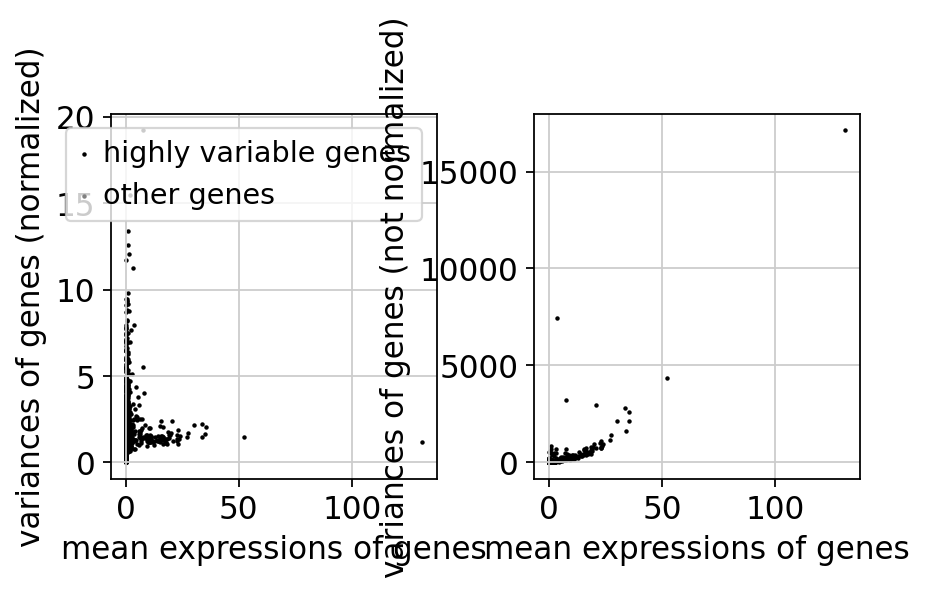

In [13]:
sc.set_figure_params(figsize=[3,3])
sc.pl.highly_variable_genes(AnnData_r)

# Move to GPU instance for SCVI

In [ ]:
warnings.resetwarnings
scvi.model.SCVI.setup_anndata(AnnData_r, layer="counts", batch_key="batch", \
                        categorical_covariate_keys=["age_group",'study','chemistry_simple','enrichment'])
vae = scvi.model.SCVI(AnnData_r,n_layers=2, n_latent=30,)
vae.train(max_epochs=300,batch_size=2000)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 286/300:  95%|██████████████████████████████████████  | 285/300 [1:19:41<03:59, 15.93s/it, loss=1.02e+03, v_num=1]

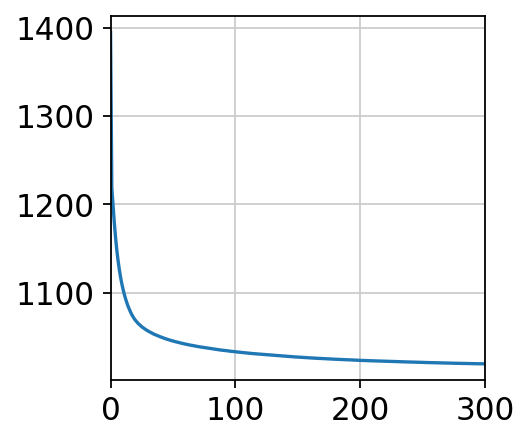

In [19]:
import matplotlib.pyplot as plt
plt.plot(vae.history['elbo_train'][:]);
plt.xlim(0, len(vae.history['elbo_train']));

In [ ]:
AnnData = sc.read_h5ad('')

In [ ]:
AnnData.obsm["X_scVI"] = vae.get_latent_representation() # return batch corrections to original anndata
sc.pp.neighbors(AnnData, use_rep="X_scVI")

In [21]:
AnnData.write_h5ad('')

In [69]:
# load object 
AnnData = sc.read_h5ad('')


In [70]:
AnnData

AnnData object with n_obs × n_vars = 588280 × 36601
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex', 'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'sex', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence', 'backup_barcode'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'neighbors'
    obsm: 'X_scVI'
    obsp: 'connectivities', 'distances'

In [71]:
sc.tl.umap(AnnData,min_dist=0.1)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:13:43)


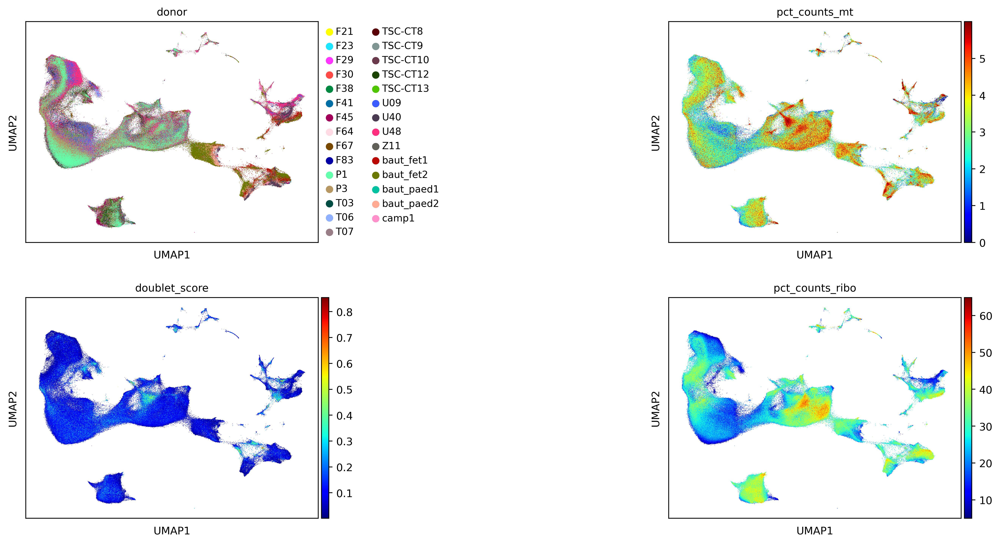

In [72]:
sc.set_figure_params(dpi=200,fontsize=10,)
sc.pl.umap(AnnData,color=['donor','pct_counts_mt','doublet_score','pct_counts_ribo'],size=0.5,cmap='jet',ncols=2,wspace=1)

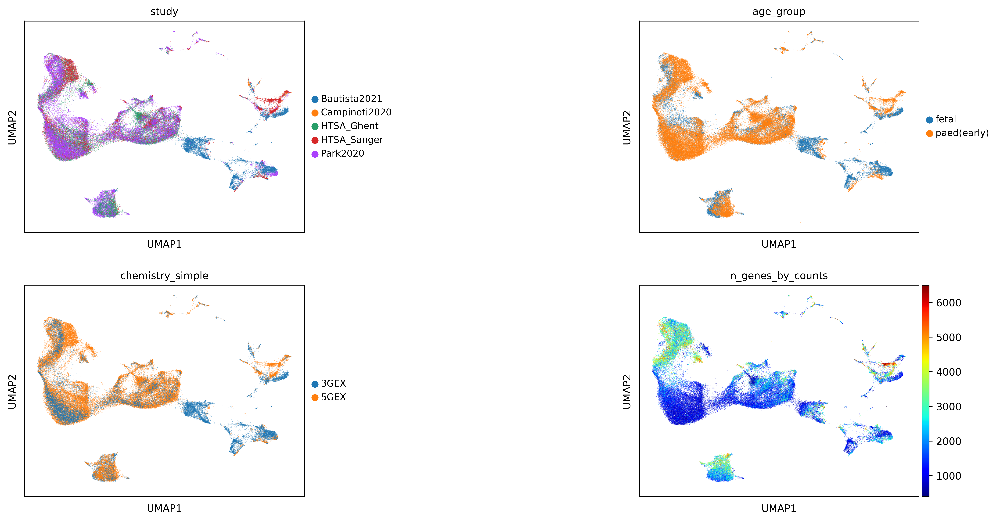

In [73]:
sc.set_figure_params(dpi=300,fontsize=10,)
sc.pl.umap(AnnData,color=['study','age_group','chemistry_simple','n_genes_by_counts'],size=0.1,cmap='jet',ncols=2,wspace=1)

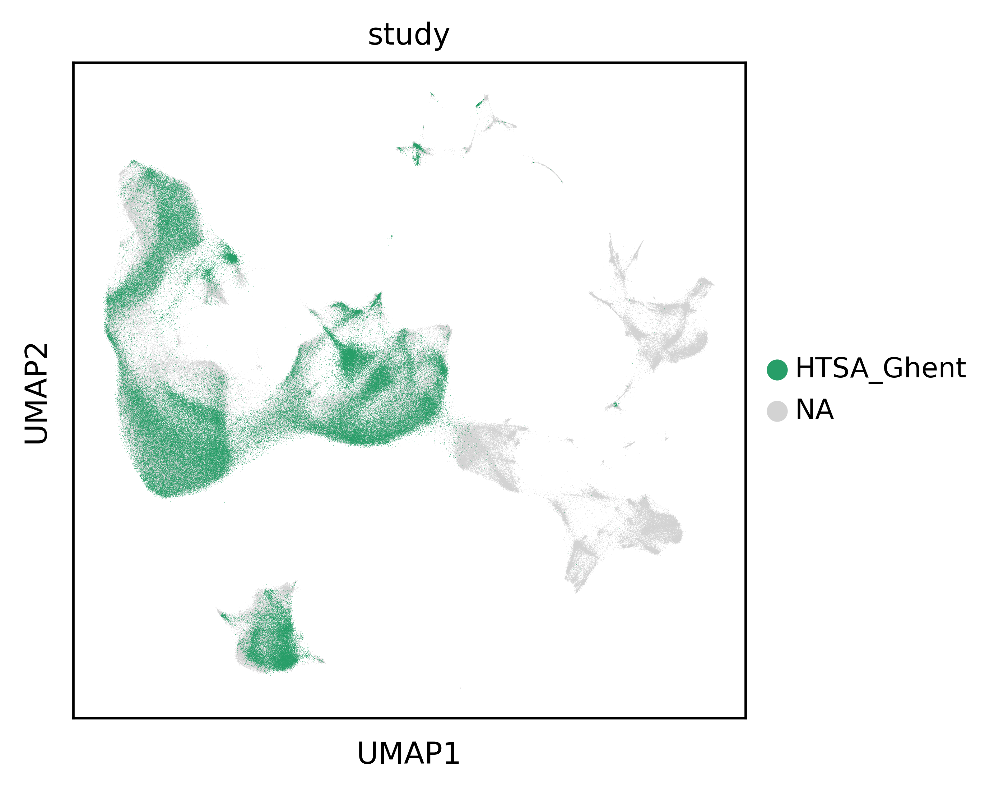

In [74]:
sc.pl.umap(AnnData,color=['study'],groups='HTSA_Ghent',size=0.1,cmap='jet',ncols=2,wspace=1)

In [75]:
AnnData.write_h5ad('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/atlas_full_post_qc_post_scvi.h5ad')

In [76]:
sc.tl.louvain(AnnData, resolution=0.5, key_added="louvian_05")
sc.tl.leiden(AnnData, resolution=0.5, key_added="leiden_05")
sc.tl.leiden(AnnData, resolution=1, key_added="leiden_1")
sc.tl.leiden(AnnData, resolution=2, key_added="leiden_2")

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvian_05', the cluster labels (adata.obs, categorical) (0:07:10)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_05', the cluster labels (adata.obs, categorical) (0:13:18)
running Leiden clustering
    finished: found 32 clusters and added
    'leiden_1', the cluster labels (adata.obs, categorical) (0:26:04)
running Leiden clustering
    finished: found 40 clusters and added
    'leiden_2', the cluster labels (adata.obs, categorical) (0:22:30)


In [77]:
AnnData.write_h5ad('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/atlas_full_post_qc_post_scvi.h5ad')

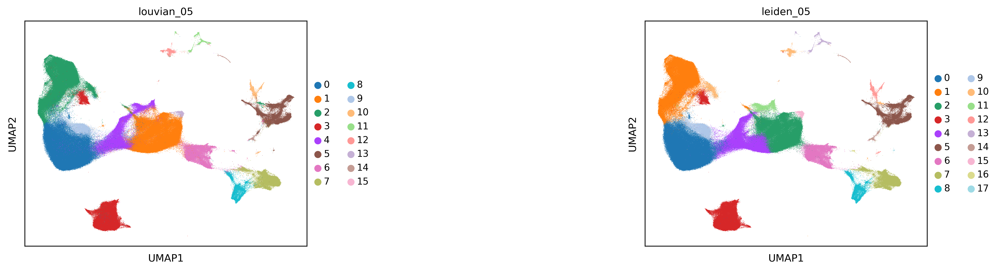

In [78]:
sc.set_figure_params(dpi=200,fontsize=10,)
sc.pl.umap(AnnData,color=['louvian_05','leiden_05'],size=0.5,cmap='jet',ncols=2,wspace=1)

# Get annotations form previuos object 

In [79]:
AnnOld = sc.read_h5ad('')

In [81]:
anno_to_map = ['annotation_level_4', 'park_2020_cell_type', 'panfetal_2022_cell_type', 'cell_type_level_4',
               'cell_type_level_3', 'cell_type_level_2', 'cell_type_level_1', 'cell_type_level_0',
                'pseudotime_nhood_vdj', 'prob_CD8+T_nhood_vdj', 'prob_CD4+T_nhood_vdj','anno_CITE_4v5']

In [82]:
# migrate annotations form old object 
for col in anno_to_map:
    AnnData.obs[col] = AnnOld.obs[col]
    AnnData.obs[col] = AnnData.obs[col].astype('category')
    

In [83]:
AnnData.obs['anno_CITE_4v5'].value_counts()

DP(Q)_rearr        76872
DP(P)_early        55390
DP_4hi8lo          25566
nan                18187
DP_pos_sel         13369
                   ...  
PeriloFb-Prolif       26
DC_Doublet            21
BT_Doublet            11
B_propre              10
RBC                    7
Name: anno_CITE_4v5, Length: 96, dtype: int64

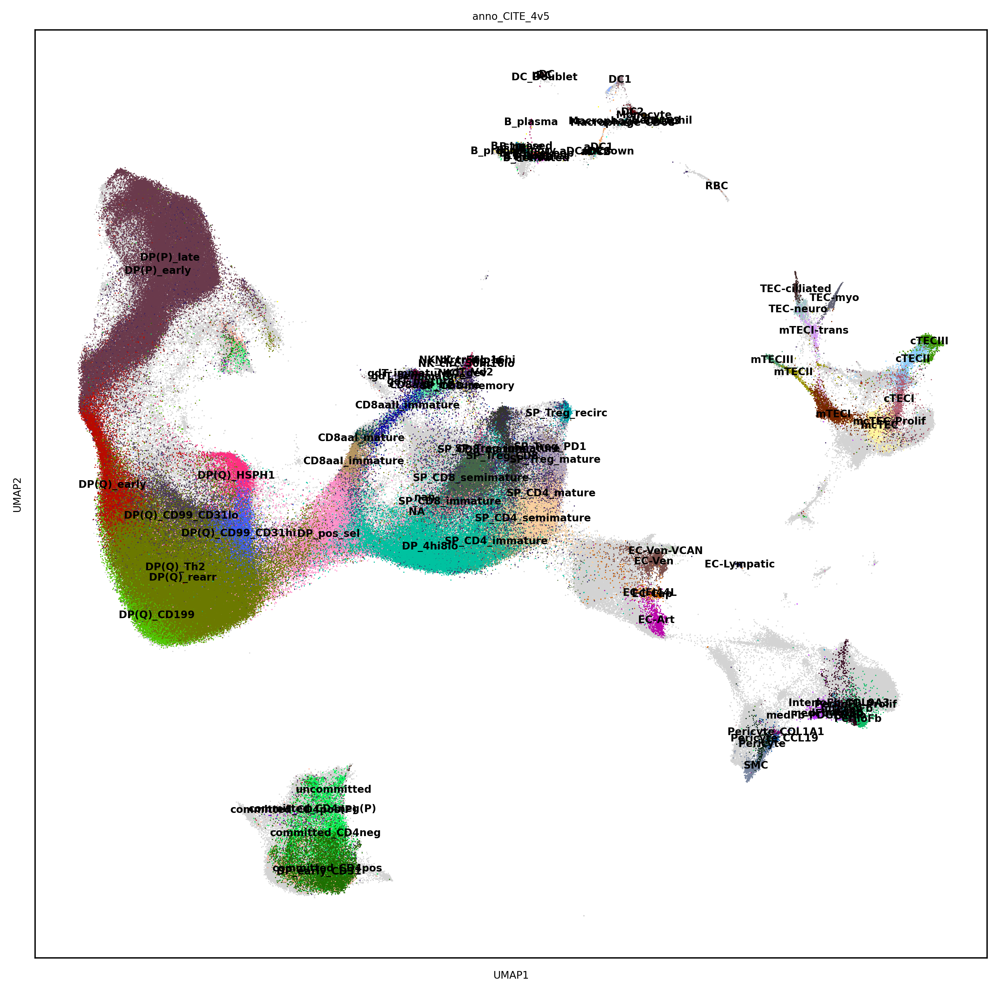

In [84]:
sc.set_figure_params(dpi=200,figsize=[10,10],fontsize=6)
sc.pl.umap(AnnData,color=['anno_CITE_4v5'],size=2,cmap='jet',ncols=2,wspace=0.5,legend_loc='on data')

In [85]:
AnnData.write_h5ad('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/atlas_full_rev_v1.h5ad')

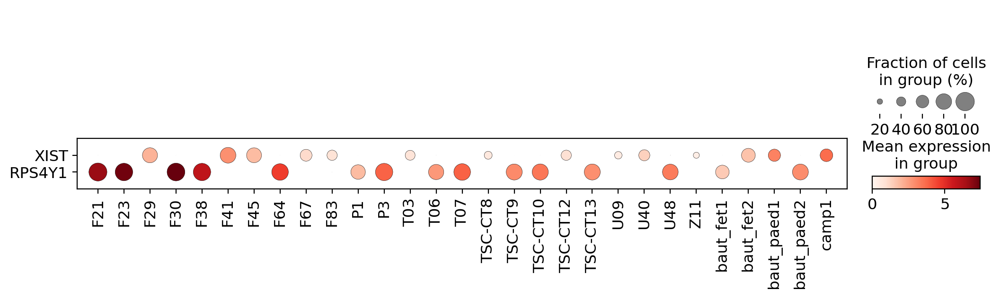

In [90]:
sc.set_figure_params(dpi=100)
sc.pl.dotplot(AnnData,var_names=['XIST','RPS4Y1'],groupby=['donor'],swap_axes=True)